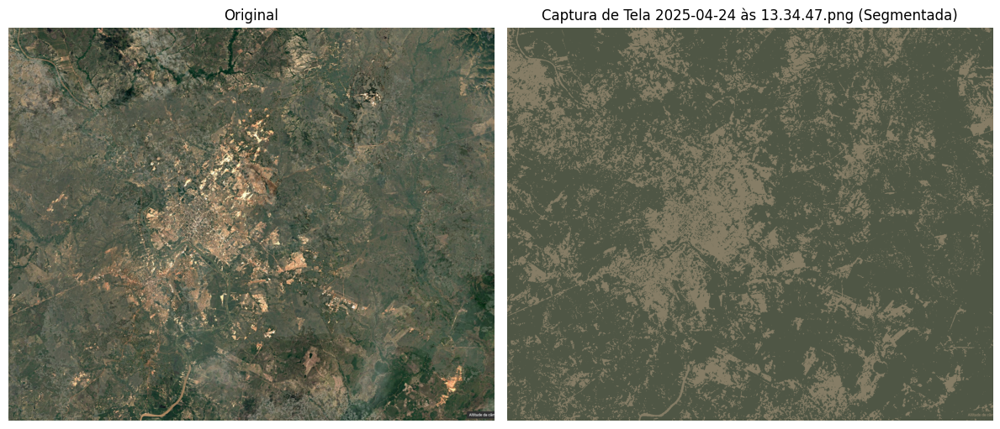

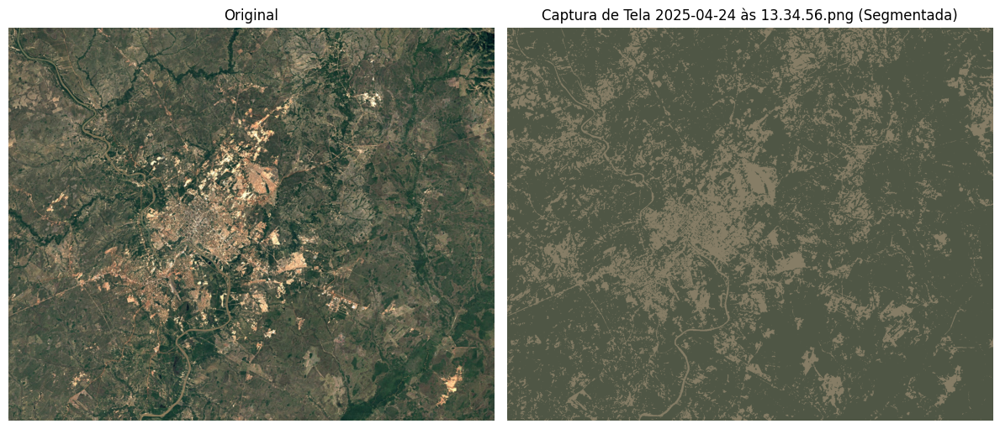

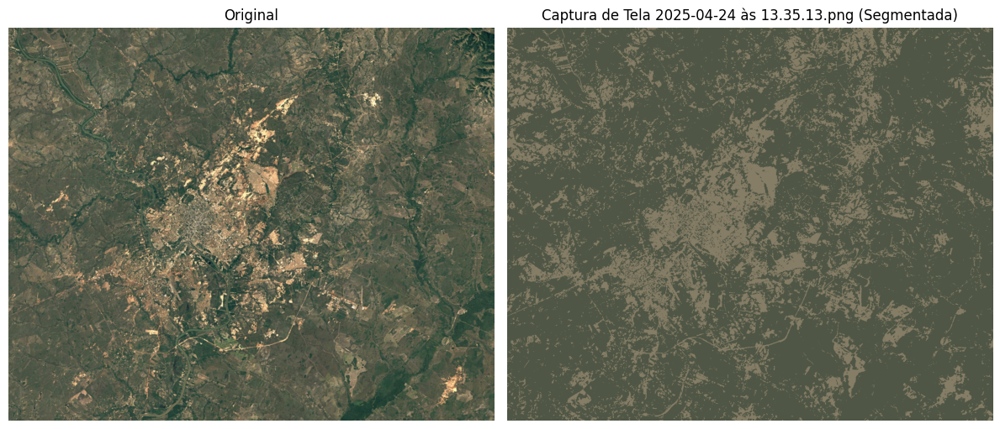

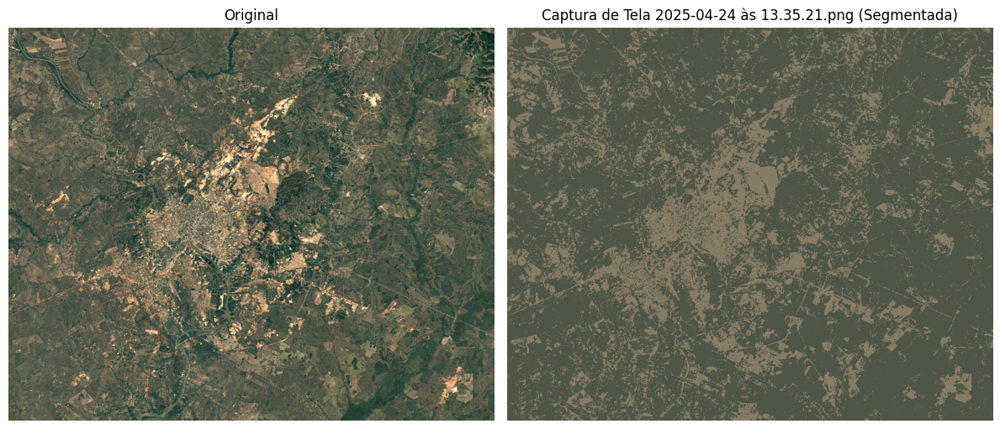

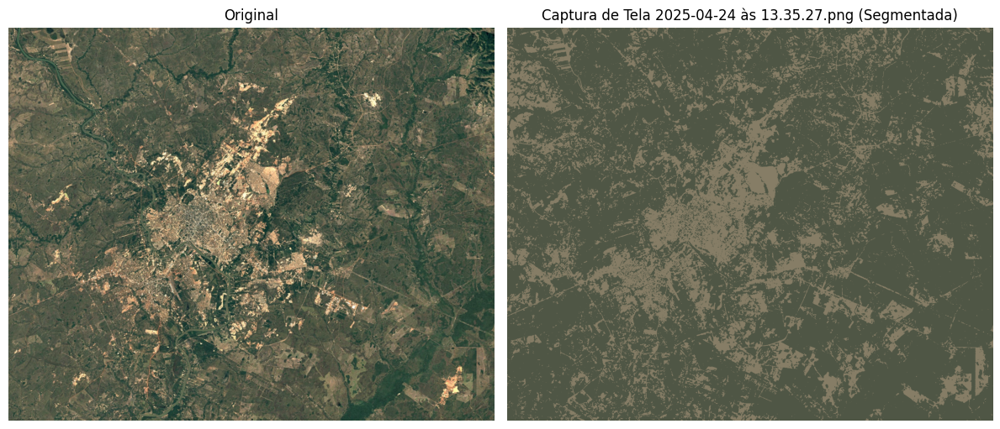

...

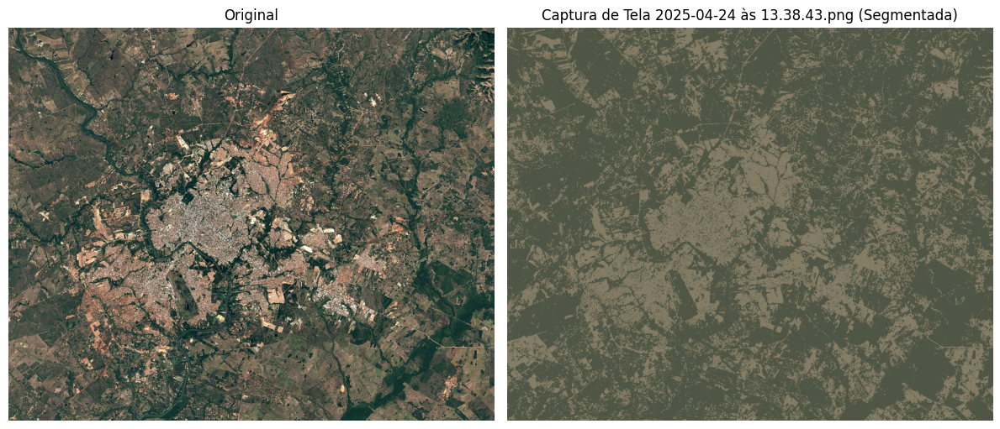

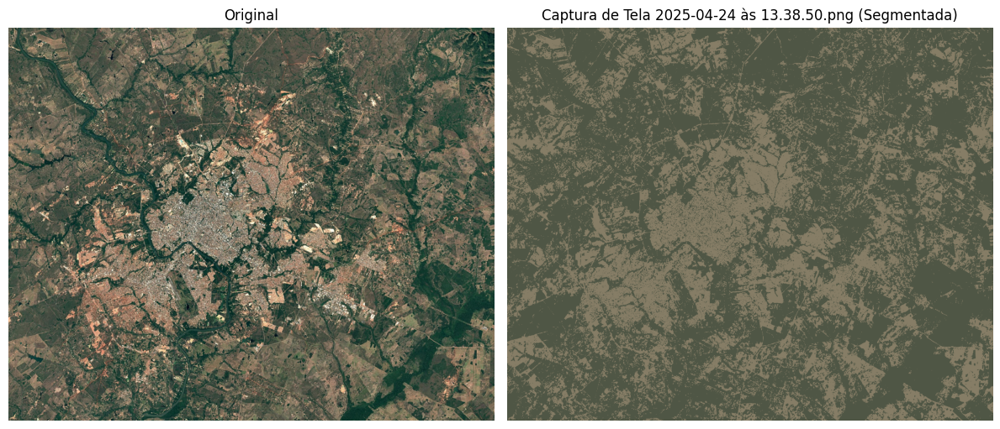

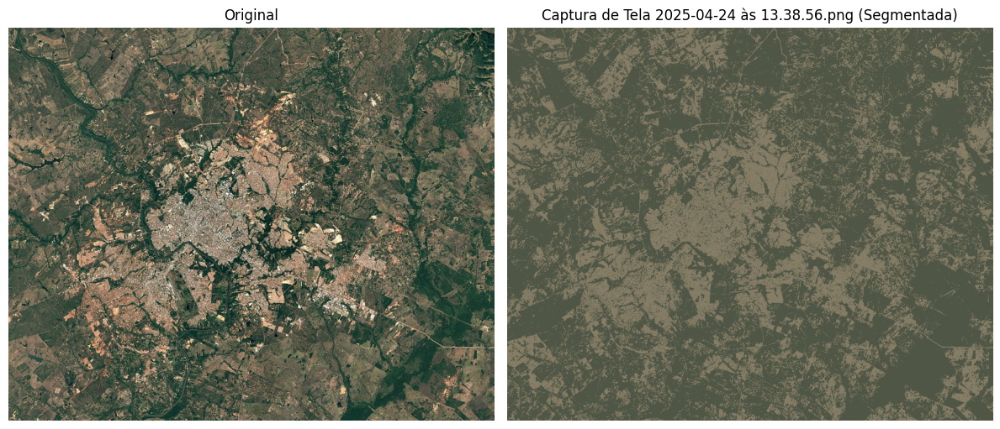

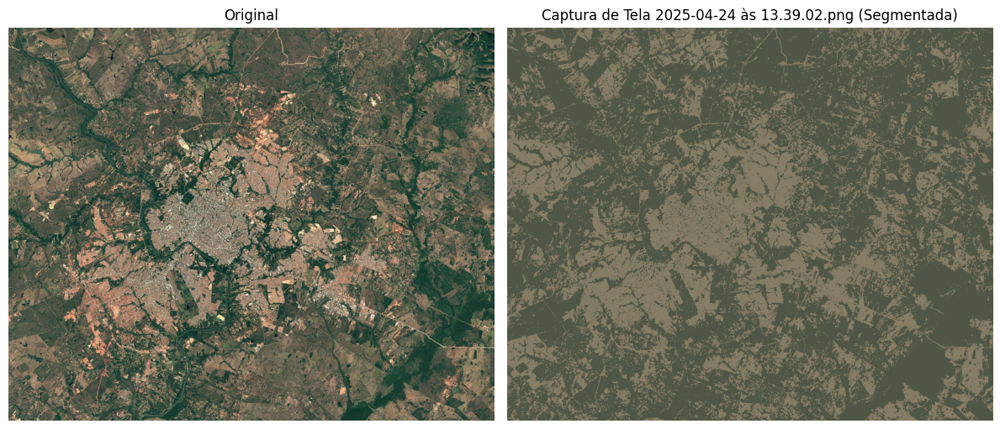

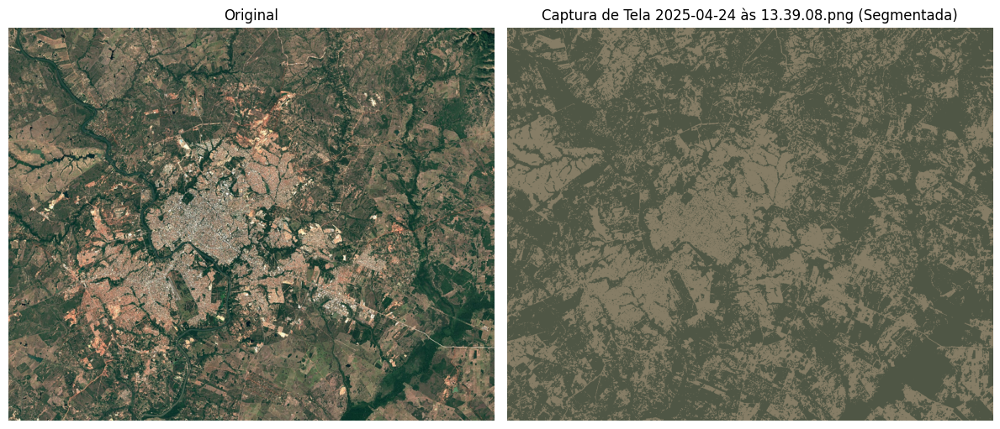

,imagem,grupo_0,grupo_1
0,Captura de Tela 2025-04-24 às 13.34.47.png,0.747407,0.252593
1,Captura de Tela 2025-04-24 às 13.34.56.png,0.782883,0.217117
2,Captura de Tela 2025-04-24 às 13.35.13.png,0.772747,0.227253
3,Captura de Tela 2025-04-24 às 13.35.21.png,0.758278,0.241722
4,Captura de Tela 2025-04-24 às 13.35.27.png,0.762046,0.237954
5,Captura de Tela 2025-04-24 às 13.35.34.png,0.782667,0.217333
6,Captura de Tela 2025-04-24 às 13.35.41.png,0.782201,0.217799
7,Captura de Tela 2025-04-24 às 13.35.48.png,0.766026,0.233974
8,Captura de Tela 2025-04-24 às 13.35.54.png,0.800364,0.199636
9,Captura de Tela 2025-04-24 às 13.36.00.png,0.827820,0.172180


In [47]:
import os
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
from sklearn.cluster import KMeans
import pandas as pd

def mostrar_cores_clusters(centroides):
    n_clusters = len(centroides)
    fig, ax = plt.subplots(figsize=(1.8 * n_clusters, 2))
    for i, cor in enumerate(centroides.astype(np.uint8)):
        ax.add_patch(plt.Rectangle((i, 0), 1, 1, color=cor/255))
        ax.text(i + 0.5, -0.2, f'Grupo {i}', ha='center', va='top', fontsize=10)
    ax.set_xlim(0, n_clusters)
    ax.set_ylim(0, 1)
    ax.axis('off')
    plt.title("Cores dos grupos (centroides do KMeans)")
    

def ler_imagens_ordenadas(pasta):
    arquivos = [os.path.join(pasta, f) for f in os.listdir(pasta) if f.lower().endswith('.png')]
    arquivos.sort(key=lambda x: os.path.getctime(x))
    return arquivos

def imagem_para_array_rgb(path):
    imagem = Image.open(path).convert('RGB')
    return np.array(imagem)

def segmentar_imagem(imagem_array, kmeans_model):
    h, w, c = imagem_array.shape
    pixels = imagem_array.reshape(-1, 3)
    pred = kmeans_model.predict(pixels)
    cores = kmeans_model.cluster_centers_.astype(np.uint8)
    imagem_segmentada = cores[pred].reshape(h, w, 3)
    return imagem_segmentada, pred

def mostrar_lado_a_lado(original, segmentada, titulo):
    fig, axs = plt.subplots(1, 2, figsize=(12, 6))
    axs[0].imshow(original)
    axs[0].set_title("Original")
    axs[0].axis('off')
    axs[1].imshow(segmentada)
    axs[1].set_title(titulo)
    axs[1].axis('off')
    plt.tight_layout()
    plt.show()

def calcular_percentuais(pred, n_clusters):
    total = len(pred)
    percentuais = [(pred == i).sum() / total for i in range(n_clusters)]
    return percentuais

# ==== PARÂMETROS ====
pasta_imagens = 'imagens'  # <-- Altere aqui
n_clusters = 2

# ==== EXECUÇÃO ====
arquivos = ler_imagens_ordenadas(pasta_imagens)
resultados = []

# Primeira imagem: treinar o KMeans
primeira = imagem_para_array_rgb(arquivos[0])
pixels_treino = primeira.reshape(-1, 3)
kmeans = KMeans(n_clusters=n_clusters, random_state=0).fit(pixels_treino)

# Loop em todas as imagens
for caminho in arquivos:
    nome = os.path.basename(caminho)
    imagem = imagem_para_array_rgb(caminho)
    segmentada, pred = segmentar_imagem(imagem, kmeans)
    mostrar_lado_a_lado(imagem, segmentada, f"{nome} (Segmentada)")

    percentuais = calcular_percentuais(pred, n_clusters)
    resultados.append({'imagem': nome, **{f'grupo_{i}': p for i, p in enumerate(percentuais)}})

# Mostrar resultado
df_resultado = pd.DataFrame(resultados)
display(df_resultado)


In [48]:
def mostrar_cores_clusters(centroides):
    n_clusters = len(centroides)
    fig, ax = plt.subplots(figsize=(1.8 * n_clusters, 2))
    for i, cor in enumerate(centroides.astype(np.uint8)):
        ax.add_patch(plt.Rectangle((i, 0), 1, 1, color=cor/255))
        ax.text(i + 0.5, -0.2, f'Grupo {i}', ha='center', va='top', fontsize=10)
    ax.set_xlim(0, n_clusters)
    ax.set_ylim(0, 1)
    ax.axis('off')
    plt.title("Cores dos grupos (centroides do KMeans)")

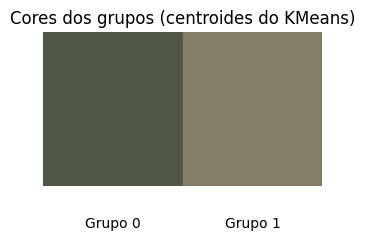

In [49]:
mostrar_cores_clusters(kmeans.cluster_centers_)

<Axes: >

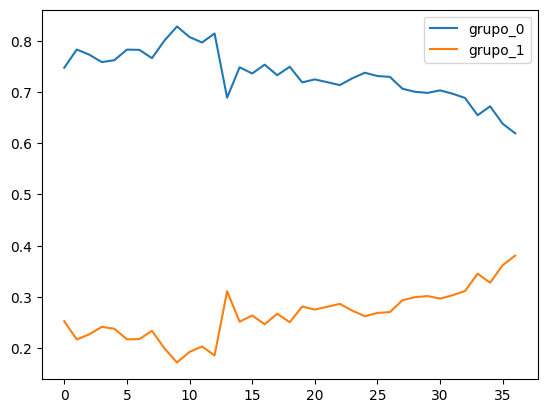

In [ ]:
df_resultado.plot()

<Axes: >

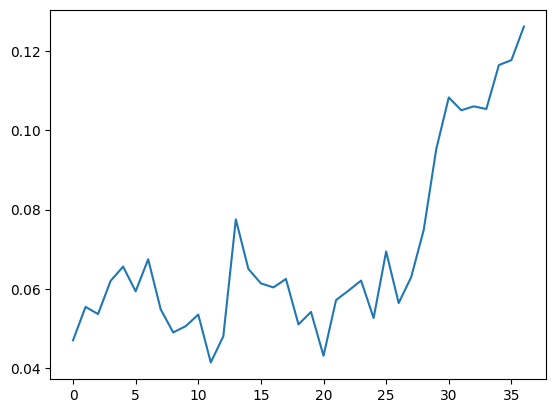

In [45]:
df_resultado[['grupo_1','grupo_3','grupo_9']].sum(axis=1).plot()

<Axes: >

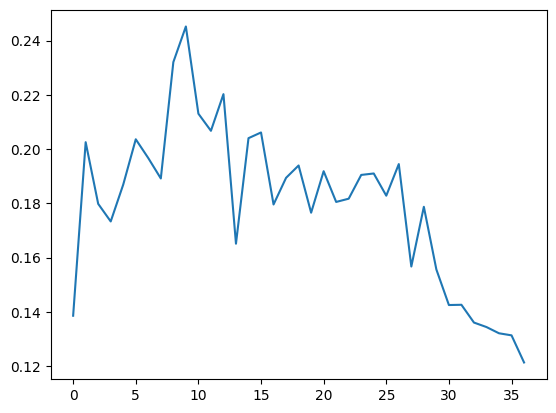

In [46]:
df_resultado[['grupo_8']].sum(axis=1).plot()